In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import os
from os import listdir
from os.path import exists

import ipywidgets as widgets
from ipywidgets import interact, interact_manual

In [2]:
path_csv = './data/Flipkart/flipkart_com-ecommerce_sample_1050.csv'
path_img = './data/Flipkart/Images'
path_img_little = './data/Flipkart/ImagesLittles'

In [3]:
data = pd.read_csv(path_csv)

In [4]:
data.describe(datetime_is_numeric=True, include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
uniq_id,1050,1050,55b85ea15a1536d46b7190ad6fff8ce7,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
crawl_timestamp,1050,149,2015-12-01 12:40:44 +0000,150,NaN,NaN,NaN,NaN,NaN,NaN,NaN
product_url,1050,1050,http://www.flipkart.com/elegance-polyester-mul...,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
product_name,1050,1050,Elegance Polyester Multicolor Abstract Eyelet ...,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
product_category_tree,1050,642,"[""Home Furnishing >> Bed Linen >> Blankets, Qu...",56,NaN,NaN,NaN,NaN,NaN,NaN,NaN
pid,1050,1050,CRNEG7BKMFFYHQ8Z,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
retail_price,1049.0,NaN,NaN,NaN,2186.197331,7639.229411,35.0,555.0,999.0,1999.0,201000.0
discounted_price,1049.0,NaN,NaN,NaN,1584.527169,7475.09968,35.0,340.0,600.0,1199.0,201000.0
image,1050,1050,55b85ea15a1536d46b7190ad6fff8ce7.jpg,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
is_FK_Advantage_product,1050,2,False,993,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
@interact
def show_data(key=data.columns):
    return data[key]

interactive(children=(Dropdown(description='key', options=('uniq_id', 'crawl_timestamp', 'product_url', 'produ…

In [6]:
# Visualisation feature par feature des NaN et catégories
data_summary = pd.DataFrame(
    {},
)


data_tmp = pd.DataFrame(
    {},
)
data_tmp["feature"] = data.columns
data_tmp["qtd_null"] = data.isnull().sum().values
data_tmp["%_null"] = (100 * data.isnull().sum() / data.shape[0]).values
data_tmp["dtype"] = data.dtypes.values
data_tmp["qtd_cat"] = [
    n if t == "object" else 0 for n, t in zip(data.nunique(), data.dtypes)
]

data_summary = pd.concat([data_summary, data_tmp], ignore_index=True)

data_summary.style.background_gradient(cmap="YlGnBu", axis=0)

,feature,qtd_null,%_null,dtype,qtd_cat
0,uniq_id,0,0.000000,object,1050
1,crawl_timestamp,0,0.000000,object,149
2,product_url,0,0.000000,object,1050
3,product_name,0,0.000000,object,1050
4,product_category_tree,0,0.000000,object,642
5,pid,0,0.000000,object,1050
6,retail_price,1,0.095238,float64,0
7,discounted_price,1,0.095238,float64,0
8,image,0,0.000000,object,1050
9,is_FK_Advantage_product,0,0.000000,bool,0


In [7]:
data['product_category_list'] = data['product_category_tree'].apply(lambda e : e[2:-2]).str.split(' >> ')
data['product_category_last'] = data['product_category_list'].apply(lambda e : e[-1])

In [8]:
data['product_category_list']

0       [Home Furnishing, Curtains & Accessories, Curt...
1       [Baby Care, Baby Bath & Skin, Baby Bath Towels...
2       [Baby Care, Baby Bath & Skin, Baby Bath Towels...
3       [Home Furnishing, Bed Linen, Bedsheets, SANTOS...
4       [Home Furnishing, Bed Linen, Bedsheets, Jaipur...
                              ...                        
1045    [Baby Care, Baby & Kids Gifts, Stickers, Oren ...
1046    [Baby Care, Baby & Kids Gifts, Stickers, Wallm...
1047    [Baby Care, Baby & Kids Gifts, Stickers, Uberl...
1048    [Baby Care, Baby & Kids Gifts, Stickers, Wallm...
1049    [Baby Care, Baby & Kids Gifts, Stickers, Uberl...
Name: product_category_list, Length: 1050, dtype: object

In [9]:
data['product_category_last']

0       Elegance Polyester Multicolor Abstract Eyelet ...
1       Sathiyas Cotton Bath Towel (3 Bath Towel, Red,...
2       Eurospa Cotton Terry Face Towel Set (20 PIECE ...
3       SANTOSH ROYAL FASHION Cotton Printed King size...
4       Jaipur Print Cotton Floral King sized Double B...
                              ...                        
1045                                Oren Empower Stickers
1046                                  Wallmantra Stickers
1047                                    Uberlyfe Stickers
1048                                  Wallmantra Stickers
1049                                    Uberlyfe Stickers
Name: product_category_last, Length: 1050, dtype: object

In [10]:
len(data['product_category_list'].explode().unique())

1126

In [11]:
import graphviz

In [12]:
dot = graphviz.Digraph()

lien_deja = set()

# Ajouter la racine de l'arbre
dot.node('Racine')

for n in data['product_category_list'].explode().unique():
    dot.node(n)

def ajouter_lien(precedent, actuel, suite):
    nom = "{}/{}".format(precedent, actuel)
    if nom not in lien_deja:
        dot.edge(precedent, actuel)
        lien_deja.add(nom)
    
    if len(suite) > 0 :
        ajouter_lien(actuel, suite[0], suite[1:])

for l in data['product_category_list']:
    ajouter_lien('Racine', l[0], l[1:])

# Afficher l'arbre
# dot.render('categories', view=True)

In [13]:
data.describe(datetime_is_numeric=True, include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
uniq_id,1050,1050,55b85ea15a1536d46b7190ad6fff8ce7,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
crawl_timestamp,1050,149,2015-12-01 12:40:44 +0000,150,NaN,NaN,NaN,NaN,NaN,NaN,NaN
product_url,1050,1050,http://www.flipkart.com/elegance-polyester-mul...,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
product_name,1050,1050,Elegance Polyester Multicolor Abstract Eyelet ...,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
product_category_tree,1050,642,"[""Home Furnishing >> Bed Linen >> Blankets, Qu...",56,NaN,NaN,NaN,NaN,NaN,NaN,NaN
pid,1050,1050,CRNEG7BKMFFYHQ8Z,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
retail_price,1049.0,NaN,NaN,NaN,2186.197331,7639.229411,35.0,555.0,999.0,1999.0,201000.0
discounted_price,1049.0,NaN,NaN,NaN,1584.527169,7475.09968,35.0,340.0,600.0,1199.0,201000.0
image,1050,1050,55b85ea15a1536d46b7190ad6fff8ce7.jpg,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
is_FK_Advantage_product,1050,2,False,993,NaN,NaN,NaN,NaN,NaN,NaN,NaN


[Text(0.5, 0, 'Valeur'), Text(0, 0.5, 'Catégorie')]

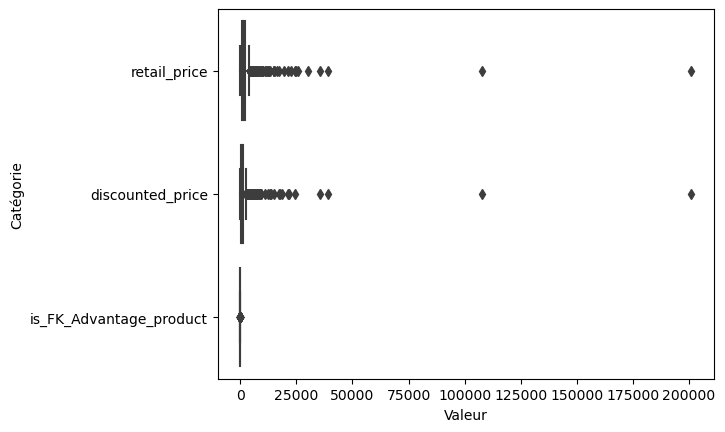

In [14]:
ax = sns.boxplot(data=data, orient="h")
ax.set(xlabel="Valeur", ylabel="Catégorie")

In [15]:
print("Liste des ID non ratachés à une image :")
for name in data['image']:
    if not exists(path_img+'/'+name):
        print(uniq_id)

Liste des ID non ratachés à une image :


In [16]:
line = data.iloc[0]

In [17]:
line

uniq_id                                     55b85ea15a1536d46b7190ad6fff8ce7
crawl_timestamp                                    2016-04-30 03:22:56 +0000
product_url                http://www.flipkart.com/elegance-polyester-mul...
product_name               Elegance Polyester Multicolor Abstract Eyelet ...
product_category_tree      ["Home Furnishing >> Curtains & Accessories >>...
pid                                                         CRNEG7BKMFFYHQ8Z
retail_price                                                          1899.0
discounted_price                                                       899.0
image                                   55b85ea15a1536d46b7190ad6fff8ce7.jpg
is_FK_Advantage_product                                                False
description                Key Features of Elegance Polyester Multicolor ...
product_rating                                           No rating available
overall_rating                                           No rating available

In [18]:
from PIL import *

In [19]:
img = Image.open(path_img+'/'+line['image'])

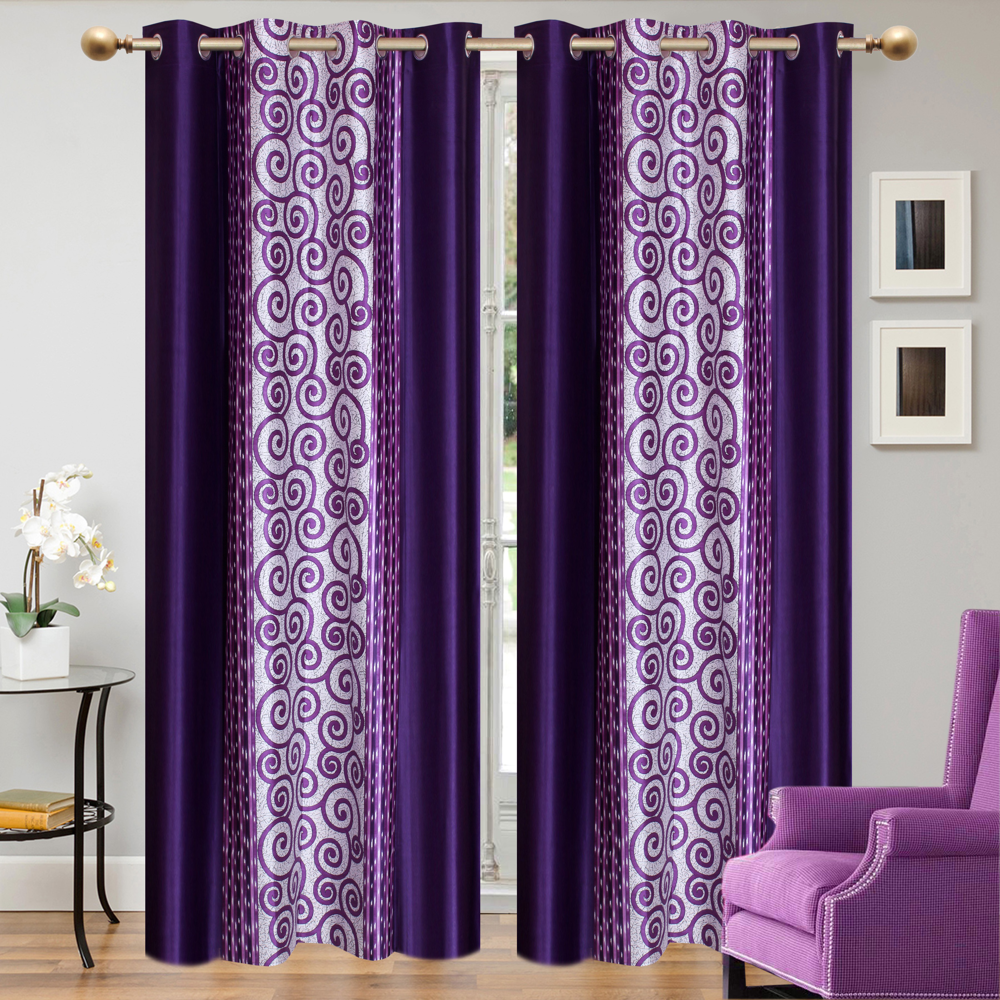

In [20]:
display(img)

In [21]:
# Récupérer et afficher la taille de l'image (en pixels)
w, h = img.size
print("Largeur : {} px, hauteur : {} px".format(w, h))

Largeur : 3600 px, hauteur : 3600 px


In [22]:
# Afficher son mode de quantification
print("Format des pixels : {}".format(img.mode))

# Récupérer et afficher la valeur du pixel à une position précise
px_value = img.getpixel((20,100))
print("Valeur du pixel situé en (20,100) : {}".format(px_value))

Format des pixels : RGB
Valeur du pixel situé en (20,100) : (211, 210, 206)


In [23]:
# Récupérer les valeurs de tous les pixels sous forme d'une matrice
mat = np.array(img)


# Afficher la taille de la matrice de pixels
print("Taille de la matrice de pixels : {}".format(mat.shape))

Taille de la matrice de pixels : (3600, 3600, 3)


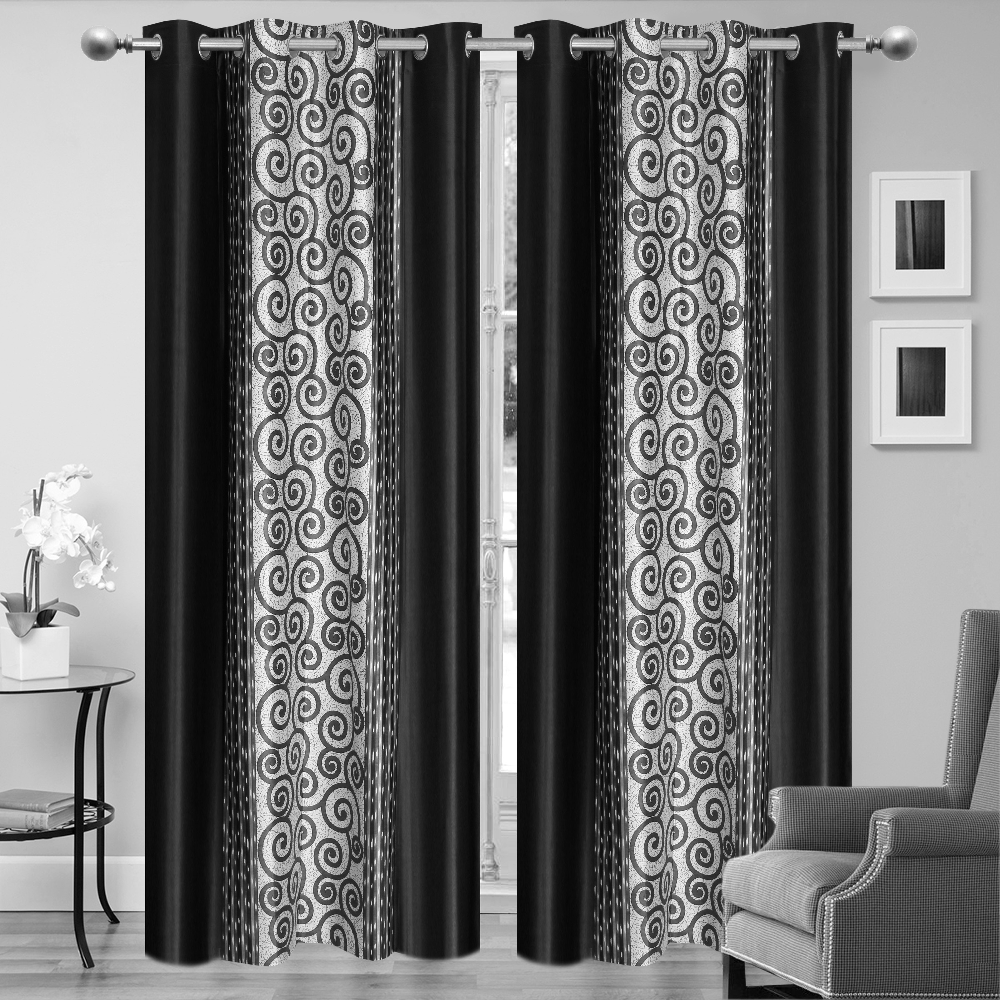

In [24]:
img.convert('L')

In [25]:
img_tmp = np.array(img.convert('L'))

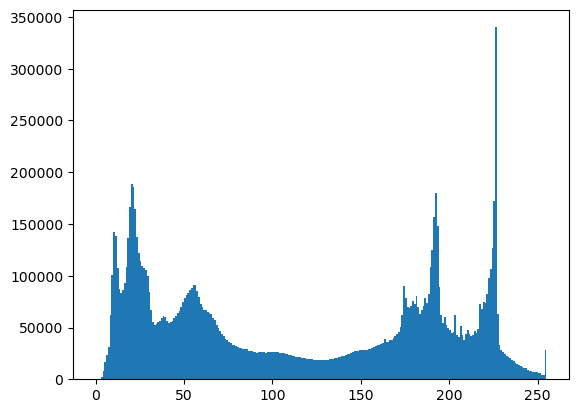

In [26]:
# Générer et afficher l'histogramme
# Pour le normaliser : argument density=True dans plt.hist
# Pour avoir l'histogramme cumulé : argument cumulative=True
n, bins, patches = plt.hist(img_tmp.flatten(), bins=range(256))
plt.show()

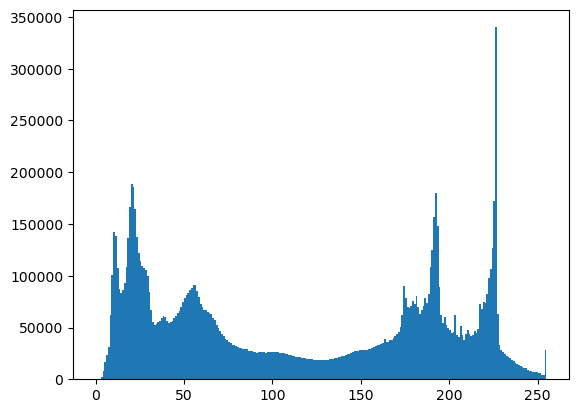

In [27]:
n, bins, patches = plt.hist(np.array(ImageOps.autocontrast(img).convert('L')).flatten(), bins=range(256))
plt.show()

In [28]:
# Répertoire d'entrée contenant les images à redimensionner
input_dir = path_img

# Répertoire de sortie pour les images redimensionnées
output_dir = path_img_little

# Taille cible pour les images redimensionnées
target_size = (500, 500)

# Parcourir le répertoire d'entrée et redimensionner chaque image
for filename in []: # os.listdir(input_dir):
    # Vérifier que le fichier est une image
    if filename.endswith(".jpg") or filename.endswith(".png"):
        # Ouvrir l'image avec PIL
        image_path = os.path.join(input_dir, filename)
        image = Image.open(image_path)
        # Redimensionner l'image avec la méthode thumbnail de PIL
        image.thumbnail(target_size)
        # Enregistrer l'image redimensionnée dans le répertoire de sortie
        output_path = os.path.join(output_dir, filename)
        image.save(output_path)

In [29]:
number_cat = 8

In [30]:
from sklearn import preprocessing

In [31]:
data_tmp = data[['image', 'product_category_last']].copy()

In [32]:
data_tmp.columns = ['img', 'cat']

In [33]:
level = 1
data_tmp['cat'] = data['product_category_list'].apply(lambda e : e[level] if len(e)>level else e[-1])

In [34]:
list_labels = list(data_tmp['cat'].explode().unique())

In [35]:
data_tmp['label'] = data_tmp['cat'].apply(lambda e : list_labels.index(e))

In [36]:
data_tmp

,img,cat,label
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Curtains & Accessories,0
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Bath & Skin,1
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Bath & Skin,1
3,d4684dcdc759dd9cdf41504698d737d8.jpg,Bed Linen,2
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,Bed Linen,2
...,...,...,...
1045,958f54f4c46b53c8a0a9b8167d9140bc.jpg,Baby & Kids Gifts,54
1046,fd6cbcc22efb6b761bd564c28928483c.jpg,Baby & Kids Gifts,54
1047,5912e037d12774bb73a2048f35a00009.jpg,Baby & Kids Gifts,54
1048,c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,Baby & Kids Gifts,54


In [37]:
data_tmp['image_path'] = data_tmp['img'].apply(lambda s : path_img+'/'+s)

In [38]:
tmp = data_tmp['cat'].value_counts()
list_labels = tmp.index[:number_cat]

In [39]:
len(tmp)

62

In [40]:
list_labels

Index(['Wrist Watches', 'Laptop Accessories', 'Infant Wear', 'Coffee Mugs',
       'Showpieces', 'Bed Linen', 'Fragrances', 'Network Components'],
      dtype='object')

In [41]:
data_little = data_tmp.loc[data_tmp['cat'].isin(list_labels)].copy().reset_index()

In [42]:
data_little

,index,img,cat,label,image_path
0,3,d4684dcdc759dd9cdf41504698d737d8.jpg,Bed Linen,2,./data/Flipkart/Images/d4684dcdc759dd9cdf41504...
1,4,6325b6870c54cd47be6ebfbffa620ec7.jpg,Bed Linen,2,./data/Flipkart/Images/6325b6870c54cd47be6ebfb...
2,5,893aa5ed55f7cff2eccea7758d7a86bd.jpg,Wrist Watches,3,./data/Flipkart/Images/893aa5ed55f7cff2eccea77...
3,6,f355cc1ccb08bd0d283ed979b7ee7515.jpg,Wrist Watches,3,./data/Flipkart/Images/f355cc1ccb08bd0d283ed97...
4,7,dd0e3470a7e6ed76fd69c2da27721041.jpg,Wrist Watches,3,./data/Flipkart/Images/dd0e3470a7e6ed76fd69c2d...
...,...,...,...,...,...
639,1032,b5834f1e97c74d2833dbcb09a3f27926.jpg,Laptop Accessories,17,./data/Flipkart/Images/b5834f1e97c74d2833dbcb0...
640,1034,7815fb39feb773db944c9f03bbdcbf64.jpg,Laptop Accessories,17,./data/Flipkart/Images/7815fb39feb773db944c9f0...
641,1035,d407ab825e1a266635214bfe893f29c4.jpg,Laptop Accessories,17,./data/Flipkart/Images/d407ab825e1a266635214bf...
642,1036,5a54c78b52c984e56500809e5bc27ae1.jpg,Laptop Accessories,17,./data/Flipkart/Images/5a54c78b52c984e56500809...


In [43]:
from sklearn import manifold, decomposition
from sklearn import manifold, decomposition

In [44]:
def show_representation(data, cat, limit=None, X_tsne=None):
    if X_tsne is None:
        tsne = manifold.TSNE(n_components=2, perplexity=30, n_iter=2000, init='random')
        X_tsne = tsne.fit_transform(data)
    
    df_tsne = pd.DataFrame(X_tsne, columns=['tsne1', 'tsne2'])
    df_tsne["class"] = cat.reset_index(drop=True)
    
    plt.figure(figsize=(8,5))
    sns.scatterplot(
        x="tsne1", y="tsne2",
        hue="class",
        palette=sns.color_palette('tab10', n_colors=number_cat), s=50,
        data=df_tsne,
        legend="brief")

    plt.title('TSNE selon les vraies classes', fontsize = 14, pad = 35, fontweight = 'bold')
    plt.xlabel('tsne1', fontsize = 14, fontweight = 'bold')
    plt.ylabel('tsne2', fontsize = 14, fontweight = 'bold')
    plt.legend(prop={'size': 8}) 

    plt.show()
    
    return X_tsne

In [45]:
import cv2
from sklearn.cluster import KMeans

In [46]:
image_array = []
for n in data_little['img']:
    img = cv2.imread(path_img+'/'+n)
    #img = cv2.normalize(img, np.zeros(img.shape), 0, 255, cv2.NORM_MINMAX)
    img = cv2.equalizeHist(cv2.cvtColor(img, cv2.COLOR_BGR2GRAY))
    image_array.append(img)

In [47]:
orb = cv2.ORB_create(nfeatures=256)
descriptors = []
for img in image_array:
    kp, des = orb.detectAndCompute(img, None)
    descriptors.append(des)

In [48]:
descriptors_concat = np.concatenate(descriptors, axis=0)

In [49]:
descriptors[0].shape

(256, 32)

In [50]:
descriptors_concat.shape

(163852, 32)

In [51]:
nb_clusters_1 = int(np.sqrt(len(descriptors_concat)))

In [52]:
kmeans = KMeans(n_clusters=nb_clusters_1, n_init='auto').fit(descriptors_concat)

In [53]:
histograms = []
for des in descriptors:
    cluster_indices = kmeans.predict(des)
    histogram, _ = np.histogram(cluster_indices, bins=range(nb_clusters_1+1), density=True)
    histograms.append(histogram)
histograms = np.vstack(histograms)

In [54]:
histograms

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.00390625],
       ...,
       [0.0078125 , 0.00390625, 0.        , ..., 0.        , 0.        ,
        0.00390625],
       [0.        , 0.00390625, 0.        , ..., 0.        , 0.        ,
        0.00390625],
       [0.        , 0.03125   , 0.        , ..., 0.015625  , 0.        ,
        0.        ]])

In [55]:
kmeans_final = KMeans(n_clusters=number_cat, n_init='auto').fit_predict(histograms)

C:\ProgramData\Anaconda3\envs\Tensorflow\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(


In [56]:
kmeans_final

array([1, 1, 1, 3, 6, 6, 1, 5, 3, 3, 3, 4, 5, 4, 5, 3, 1, 1, 1, 3, 1, 3,
       6, 3, 1, 3, 1, 2, 5, 3, 1, 3, 5, 2, 3, 2, 4, 6, 3, 5, 5, 5, 5, 5,
       1, 1, 3, 3, 3, 2, 5, 1, 5, 0, 3, 3, 3, 1, 3, 6, 1, 1, 5, 4, 1, 1,
       5, 4, 2, 4, 7, 2, 1, 3, 2, 1, 2, 1, 2, 5, 2, 4, 3, 7, 3, 2, 2, 3,
       6, 7, 5, 2, 2, 6, 3, 3, 3, 1, 2, 1, 3, 5, 2, 2, 4, 3, 1, 4, 3, 3,
       2, 2, 3, 4, 3, 1, 3, 2, 3, 3, 3, 2, 1, 2, 2, 3, 1, 2, 2, 7, 6, 5,
       2, 5, 1, 2, 5, 5, 1, 2, 6, 5, 1, 5, 5, 1, 6, 1, 5, 5, 3, 3, 2, 5,
       5, 2, 3, 5, 5, 1, 5, 5, 1, 1, 4, 1, 5, 3, 6, 4, 6, 3, 3, 5, 2, 5,
       1, 6, 5, 1, 3, 5, 3, 3, 0, 1, 0, 4, 3, 1, 6, 5, 6, 3, 4, 4, 3, 5,
       2, 4, 2, 1, 0, 6, 5, 2, 4, 1, 2, 3, 1, 6, 1, 4, 7, 4, 6, 5, 4, 7,
       6, 6, 6, 7, 3, 7, 7, 6, 7, 7, 3, 4, 7, 1, 6, 7, 3, 6, 1, 3, 3, 4,
       3, 1, 1, 7, 1, 7, 4, 7, 7, 4, 1, 4, 1, 6, 3, 7, 6, 7, 7, 1, 3, 2,
       5, 7, 6, 7, 1, 5, 1, 3, 3, 0, 6, 3, 7, 6, 1, 5, 3, 4, 1, 2, 4, 6,
       1, 7, 2, 3, 3, 3, 6, 6, 2, 3, 7, 1, 4, 3, 1,

In [57]:
kmeans = KMeans(n_clusters=number_cat, n_init='auto').fit(descriptors_concat)

In [58]:
histograms = []
for des in descriptors:
    cluster_indices = kmeans.predict(des)
    histogram, _ = np.histogram(cluster_indices, bins=range(number_cat+1), density=True)
    histograms.append(histogram)
histograms = np.vstack(histograms)

In [59]:
image_clusters = [[] for _ in range(number_cat+1)]
for i, hist in enumerate(histograms):
    cluster_index = np.argmax(hist)
    image_clusters[cluster_index].append(i)

In [60]:
image_clusters

[[0,
  1,
  8,
  10,
  29,
  36,
  38,
  44,
  48,
  51,
  54,
  61,
  69,
  72,
  73,
  87,
  97,
  100,
  106,
  109,
  116,
  118,
  122,
  126,
  134,
  145,
  150,
  151,
  162,
  167,
  172,
  179,
  180,
  182,
  185,
  201,
  236,
  240,
  256,
  262,
  271,
  278,
  279,
  289,
  290,
  305,
  306,
  310,
  336,
  340,
  359,
  362,
  365,
  368,
  386,
  391,
  392,
  396,
  402,
  404,
  405,
  406,
  408,
  412,
  417,
  425,
  428,
  442,
  471,
  482,
  483,
  503,
  506,
  508,
  515,
  518,
  524,
  535,
  551,
  567,
  568,
  592,
  593,
  598,
  599,
  601,
  603,
  605,
  606,
  611,
  617,
  628,
  630,
  631],
 [7,
  62,
  66,
  70,
  76,
  85,
  111,
  136,
  137,
  154,
  155,
  160,
  178,
  198,
  204,
  214,
  235,
  257,
  263,
  265,
  267,
  283,
  296,
  347,
  348,
  349,
  350,
  364,
  400,
  410,
  424,
  435,
  444,
  452,
  461,
  463,
  470,
  481,
  489,
  491,
  501,
  504,
  511,
  514,
  537,
  552,
  562,
  563,
  575,
  577,
  584,
  585,
  59

In [61]:
for l in image_clusters:
    print("\nVont ensemble :")
    for i in l:
        print(data_little['cat'][i])


Vont ensemble :
Bed Linen
Bed Linen
Wrist Watches
Wrist Watches
Wrist Watches
Network Components
Coffee Mugs
Infant Wear
Infant Wear
Showpieces
Showpieces
Infant Wear
Coffee Mugs
Coffee Mugs
Coffee Mugs
Coffee Mugs
Coffee Mugs
Coffee Mugs
Coffee Mugs
Coffee Mugs
Coffee Mugs
Coffee Mugs
Coffee Mugs
Coffee Mugs
Showpieces
Showpieces
Showpieces
Infant Wear
Showpieces
Showpieces
Showpieces
Showpieces
Showpieces
Wrist Watches
Wrist Watches
Showpieces
Fragrances
Fragrances
Fragrances
Fragrances
Fragrances
Fragrances
Network Components
Fragrances
Network Components
Fragrances
Network Components
Fragrances
Bed Linen
Infant Wear
Wrist Watches
Wrist Watches
Wrist Watches
Wrist Watches
Wrist Watches
Wrist Watches
Wrist Watches
Wrist Watches
Wrist Watches
Wrist Watches
Wrist Watches
Wrist Watches
Wrist Watches
Wrist Watches
Wrist Watches
Wrist Watches
Wrist Watches
Wrist Watches
Infant Wear
Infant Wear
Infant Wear
Bed Linen
Infant Wear
Wrist Watches
Bed Linen
Bed Linen
Wrist Watches
Wrist Watches

In [62]:
histograms.shape

(644, 8)

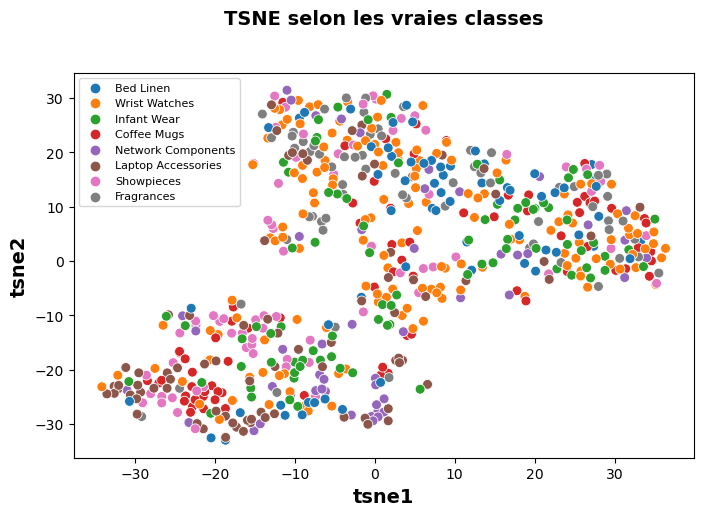

In [63]:
show_representation(histograms, data_little['cat'])
pass

In [64]:
cat_ORB = histograms

In [65]:
img = cv2.imread(path_img+'/'+line['image'], cv2.IMREAD_GRAYSCALE)
img = cv2.normalize(img, np.zeros(img.shape), 0, 255, cv2.NORM_MINMAX)

In [66]:
orb = cv2.ORB_create(nfeatures=256)

In [67]:
keypoints_orb, descriptors = orb.detectAndCompute(img, None)

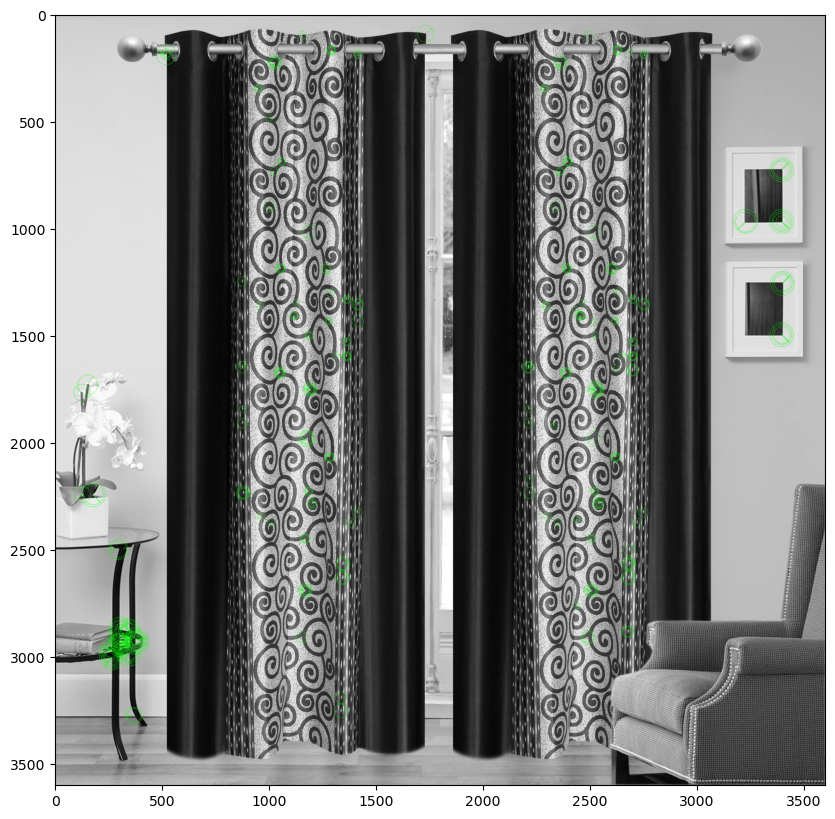

In [68]:
img = cv2.drawKeypoints(img, keypoints_orb, 0, (0, 255, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
plt.figure(figsize=(10, 10))
plt.imshow(img)
plt.show()

In [69]:
descriptors

array([[190, 236, 102, ...,  55,  46, 222],
       [ 14, 123, 103, ..., 167,  39, 241],
       [ 66, 184, 146, ...,  68, 167,  91],
       ...,
       [ 26, 205,   2, ...,  14, 176, 136],
       [ 35,  38,  64, ..., 206,  90, 133],
       [251,  97, 106, ...,  15, 126, 198]], dtype=uint8)

In [70]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import os
from os import listdir
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, auc, roc_auc_score, roc_curve
from glob import glob

import tensorflow as tf
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import GlobalAveragePooling2D, GlobalAveragePooling1D, Flatten, Dense, Dropout 
from tensorflow.keras.layers import Rescaling, RandomFlip, RandomRotation, RandomZoom
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.utils import to_categorical

# os.environ["TF_KERAS"]='1'
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  0


Bed Linen


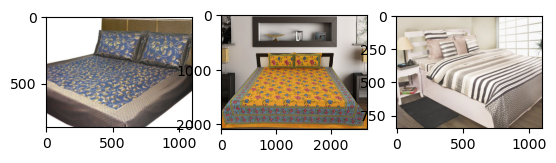

Wrist Watches


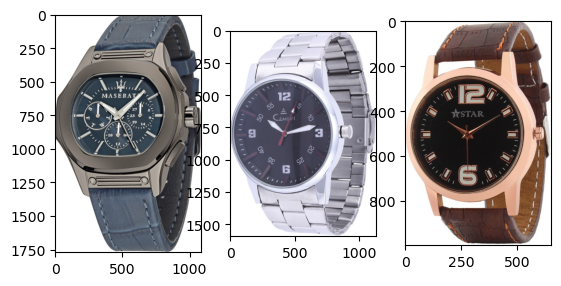

Infant Wear


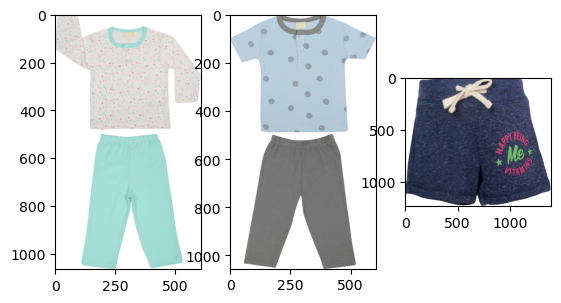

Coffee Mugs


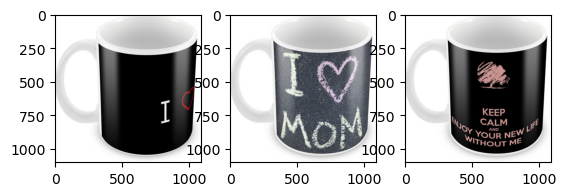

Network Components


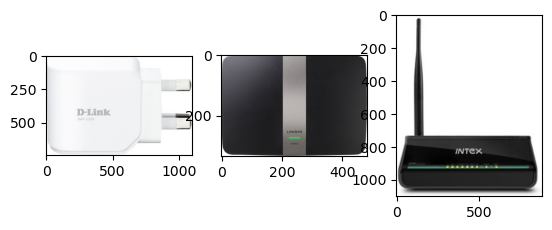

Laptop Accessories


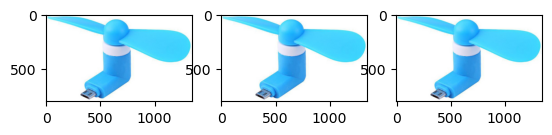

Showpieces


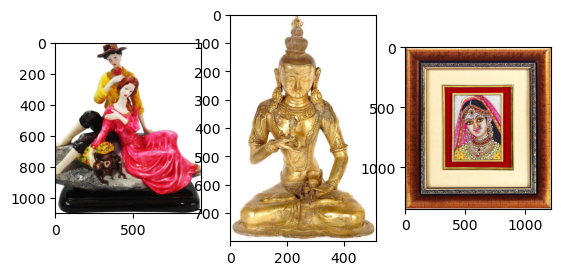

Fragrances


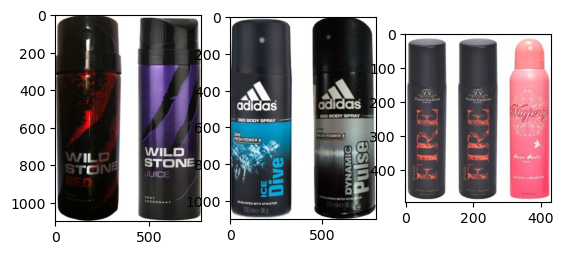

In [71]:
from matplotlib.image import imread

def list_fct(name) :
    list_image_name = [data_tmp["image_path"][i] for i in range(len(data_tmp)) if data_tmp["cat"][i]==name]
    return list_image_name

for name in data_little['cat'].unique():
    print(name)
    # print("-------")
    for i in range(3):
        plt.subplot(130 + 1 + i)
        filename = list_fct(name)[i]
        image = imread(filename)
        plt.imshow(image)
    plt.show()

In [72]:
#from tensorflow.keras.applications.xception import Xception as VGG16
#from tensorflow.keras.applications.xception import preprocess_input

In [73]:
base_model = VGG16()
model = Model(inputs=base_model.inputs, outputs=base_model.layers[-2].output)

print(model.summary())

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [74]:
images_features = []
i=0 
for image_file in data_little["img"] :
    if i%25 == 0 : print(i)
    i +=1
    image = load_img(path_img+'/'+image_file, target_size=(224, 224))
    image = img_to_array(image) 
    image = np.expand_dims(image, axis=0)
    image = preprocess_input(image)
    images_features.append(model.predict(image, verbose=0)[0]) # predict from pretrained model

images_features = np.asarray(images_features)
images_features.shape

0
25
50
75
100
125
150
175
200
225
250
275
300
325
350
375
400
425
450
475
500
525
550
575
600
625


(644, 4096)

In [75]:
from sklearn.metrics.cluster import adjusted_rand_score

In [76]:
from sklearn import manifold, decomposition

print(images_features.shape)
pca = decomposition.PCA(n_components=0.99)
feat_pca= pca.fit_transform(images_features)
print(feat_pca.shape)

(644, 4096)
(644, 503)


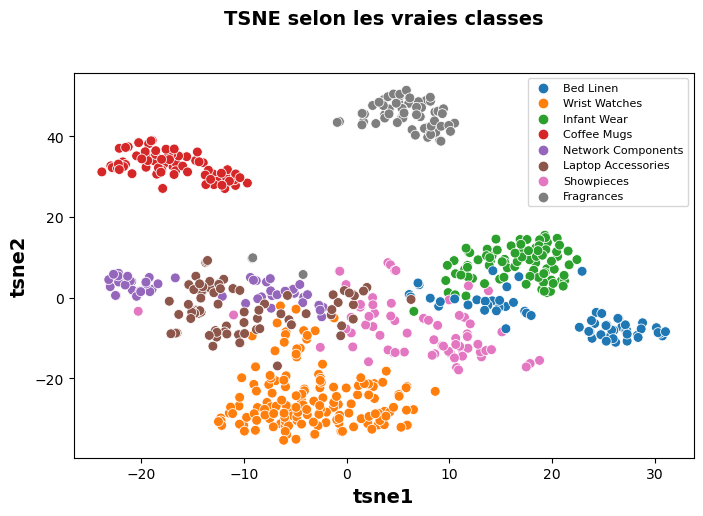

In [77]:
X_tsne = show_representation(feat_pca, data_little['cat'])

In [78]:
from sklearn import cluster, metrics

cls = cluster.KMeans(n_clusters=number_cat, n_init=100)
cls.fit(feat_pca)

C:\ProgramData\Anaconda3\envs\Tensorflow\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(


KMeans(n_init=100)

In [79]:
adjusted_rand_score(data_little['cat'], cls.labels_)

0.711552430982137

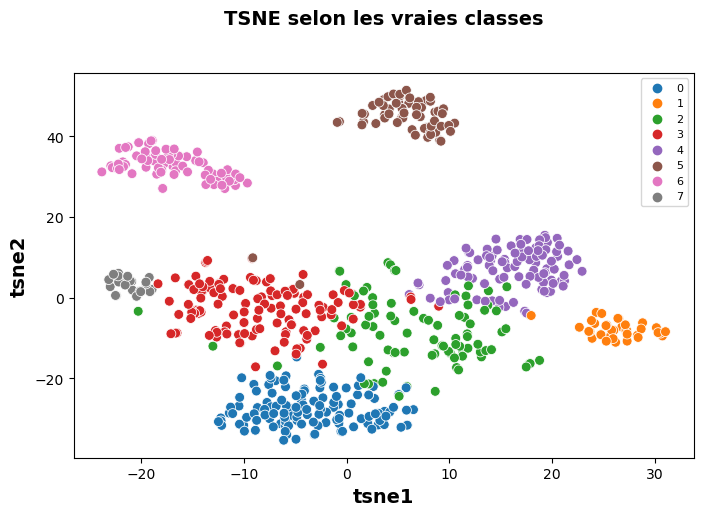

In [80]:
X_tsne = show_representation(feat_pca, pd.Series(cls.labels_), X_tsne=X_tsne)

In [81]:
cat_ORB_final = pd.Series(dtype='int', index = data_little.index)

In [82]:
for i in range(number_cat):
    cat_ORB_final.loc[image_clusters[i]] = i

In [83]:
adjusted_rand_score(data_little['cat'], cat_ORB_final)

0.03399123286961602

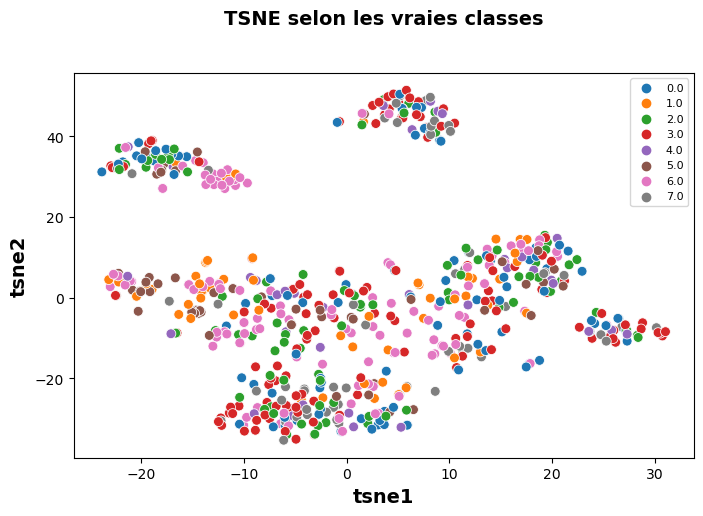

In [84]:
X_tsne = show_representation(feat_pca, cat_ORB_final, X_tsne=X_tsne)

In [85]:
adjusted_rand_score(data_little['cat'], kmeans_final)

0.05279283793303569

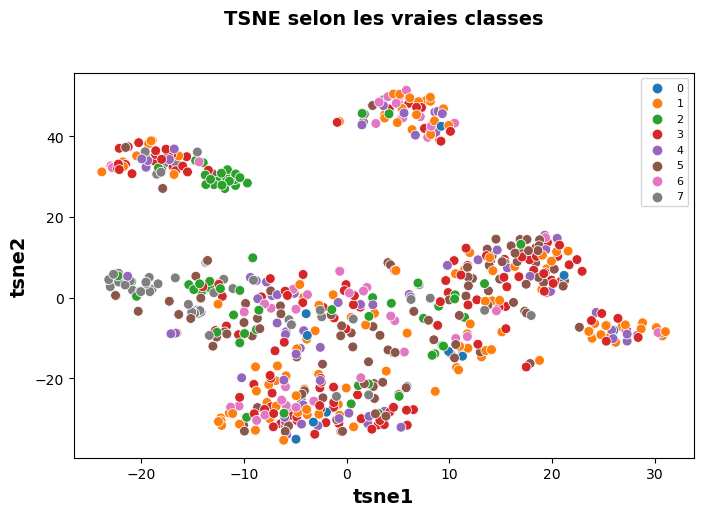

In [86]:
X_tsne = show_representation(feat_pca, pd.Series(kmeans_final), X_tsne=X_tsne)